<b>Covarian Estimation</b><br>
--
Before read this code, you should :
* Know the basics of Bayesian inference.
* Have some familiarity with an MCMC sampling library
* Have a solid grasp of NumPy
* Have at least passing familiarity with TensorFlow, but not necessarily expertise.
<br>

Import library first!

In [3]:
import collections
import math
import os
import time

import numpy as np
import pandas as pd
import scipy
import scipy.stats
import matplotlib.pyplot as plt

import tensorflow.compat.v2 as tf
tf.enable_v2_behavior()

In [4]:
import tensorflow_probability as tfp
tfd = tfp.distributions
tfb = tfp.bijectors

In [6]:
# We're assuming 2-D data with a known true mean of (0, 0)
true_mean = np.zeros([2], dtype=np.float32)
# We'll make the 2 coordinates correlated
true_cor = np.array([[1.0, 0.9], [0.9, 1.0]], dtype=np.float32)
# And we'll give the 2 coordinates different variances
true_var = np.array([4.0, 1.0], dtype=np.float32)
# Combine the variances and correlations into a covariance matrix
true_cov = np.expand_dims(np.sqrt(true_var), axis=1).dot(
    np.expand_dims(np.sqrt(true_var), axis=1).T) * true_cor
# We'll be working with precision matrices, so we'll go ahead and compute the
# true precision matrix here
true_precision = np.linalg.inv(true_cov)

In [8]:
print('eigenvalues: ', np.linalg.eigvals(true_cov))

eigenvalues:  [4.843075   0.15692513]


Note that TensorFlow Probability uses the convention that the initial dimension(s) of your data represent sample indices, and the final dimension(s) of your data represent the dimensionality of your samples.<br>
Here we want 100 samples, each of which is a vector of length 2. We'll generate an array my_data with shape (100, 2). my_data[i, :] is the ith sample, and it is a vector of length 2.

In [9]:
# Create first the data!
np.random.seed(123)

my_data = np.random.multivariate_normal(
    mean=true_mean, cov=true_cov, size=100,
    check_valid='ignore').astype(np.float32)

In [12]:
my_data.shape

(100, 2)

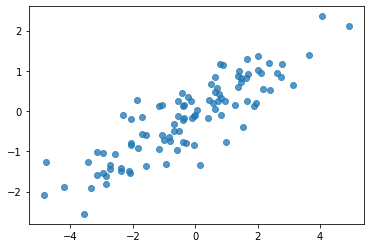

In [14]:
# One potential source of bugs is messing up your synthetic data! Let's do some simple checks.
plt.scatter(my_data[:, 0], my_data[:, 1], alpha=0.75)
plt.show()

In [16]:
print('mean of observations:', np.mean(my_data, axis=0))
print('true mean:', true_mean)
print('covariance of observations:\n', np.cov(my_data, rowvar=False))
print('true covariance:\n', true_cov)

mean of observations: [-0.24009615 -0.16638893]
true mean: [0. 0.]
covariance of observations:
 [[3.95307734 1.68718486]
 [1.68718486 0.94910269]]
true covariance:
 [[4.  1.8]
 [1.8 1. ]]


In [18]:
# Implement the likelihood function in NumPy
# First we'll implement the data log likelihood piece. That's pretty straightforward.

def log_lik_data_numpy(precision, data):
  cov = np.linalg.inv(precision)
  rv = scipy.stats.multivariate_normal(true_mean, cov)
  return np.sum(rv.logpdf(data))

# Test case: compute the log
log_lik_data_numpy(true_precision, my_data)

-280.81822950593767

In [19]:
# We're going to use a Wishart prior for the precision matrix since there's an analytical solution for the posterior

PRIOR_DF = 3
PRIOR_SCALE = np.eye(2, dtype=np.float32) / PRIOR_DF

def log_lik_prior_numpy(precision):
  rv = scipy.stats.wishart(df=PRIOR_DF, scale=PRIOR_SCALE)
  return rv.logpdf(precision)

log_lik_prior_numpy(true_precision)

-9.103606346649766

In [20]:
# Multivariate normal

n = my_data.shape[0]
nu_prior = PRIOR_DF
v_prior = PRIOR_SCALE
nu_posterior = nu_prior + n
v_posterior = np.linalg.inv(np.linalg.inv(v_prior) + my_data.T.dot(my_data))
posterior_mean = nu_posterior * v_posterior
v_post_diag = np.expand_dims(np.diag(v_posterior), axis=1)
posterior_sd = np.sqrt(nu_posterior *
                       (v_posterior ** 2.0 + v_post_diag.dot(v_post_diag.T)))

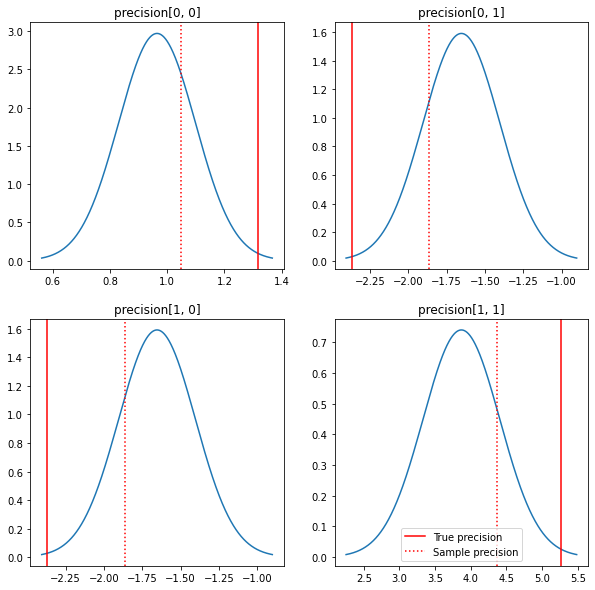

In [22]:
# A quick plot of the posteriors and the true values. Note that the posteriors are close to the sample posteriors but are shrunk a bit toward the identity.

sample_precision = np.linalg.inv(np.cov(my_data, rowvar=False, bias=False))
fig, axes = plt.subplots(2, 2)
fig.set_size_inches(10, 10)
for i in range(2):
  for j in range(2):
    ax = axes[i, j]
    loc = posterior_mean[i, j]
    scale = posterior_sd[i, j]
    xmin = loc - 3.0 * scale
    xmax = loc + 3.0 * scale
    x = np.linspace(xmin, xmax, 1000)
    y = scipy.stats.norm.pdf(x, loc=loc, scale=scale)
    ax.plot(x, y)
    ax.axvline(true_precision[i, j], color='red', label='True precision')
    ax.axvline(sample_precision[i, j], color='red', linestyle=':', label='Sample precision')
    ax.set_title('precision[%d, %d]' % (i, j))
plt.legend()
plt.show()

<i>Implement the likelihood function in TensorFlow<i>
--

In [23]:
# Normal Distribution
norm1 = tfd.Normal(loc=0., scale=1.)
probs1 = norm1.log_prob(tf.constant([1., 0.5, 0.]))

# Case 2: Get log probabilities for a vector of independent draws from
# multiple normal distributions with different parameters.  Note the vector
# values for loc and scale in the Normal constructor.
norm2 = tfd.Normal(loc=[0., 2., 4.], scale=[1., 1., 1.])
probs2 = norm2.log_prob(tf.constant([1., 0.5, 0.]))

In [25]:
print('iid draws from a single normal:', probs1.numpy())
print('draws from a batch of normals:', probs2.numpy())

iid draws from a single normal: [-1.4189385 -1.0439385 -0.9189385]
draws from a batch of normals: [-1.4189385 -2.0439386 -8.918939 ]


In [26]:
# We'll definitely want to turn on validation while we're debugging! Once everything is working, we can turn validation off if speed is really critical.

VALIDATE_ARGS = True
ALLOW_NAN_STATS = False

In [31]:
def log_lik_data(precisions, replicated_data):
  n = tf.shape(precisions)[0]  
  precisions_cholesky = tf.linalg.cholesky(precisions)
  covariances = tf.linalg.cholesky_solve(
      precisions_cholesky, tf.linalg.eye(2, batch_shape=[n]))
  rv_data = tfd.MultivariateNormalFullCovariance(
      loc=tf.zeros([n, 2]),
      covariance_matrix=covariances,
      validate_args=VALIDATE_ARGS,
      allow_nan_stats=ALLOW_NAN_STATS)

  return tf.reduce_sum(rv_data.log_prob(replicated_data), axis=0)

replicated_data = np.tile(np.expand_dims(my_data, axis=1), reps=[1, 2, 1])
print(replicated_data.shape)

(100, 2, 2)


In [33]:
# Check against the numpy implementation

precisions = np.stack([np.eye(2, dtype=np.float32), true_precision])
n = precisions.shape[0]
lik_tf = log_lik_data(precisions, replicated_data=replicated_data).numpy()

for i in range(n):
  print(i)
  print('numpy:', log_lik_data_numpy(precisions[i], my_data))
  print('tensorflow:', lik_tf[i])

0
numpy: -430.71218815801365
tensorflow: -430.7122
1
numpy: -280.81822950593767
tensorflow: -280.81824


In [36]:
# The prior is easier since we don't have to worry about data replication.

@tf.function(autograph=False)
def log_lik_prior(precisions):
  rv_precision = tfd.WishartTriL(
      df=PRIOR_DF,
      scale_tril=tf.linalg.cholesky(PRIOR_SCALE),
      validate_args=VALIDATE_ARGS,
      allow_nan_stats=ALLOW_NAN_STATS)
  return rv_precision.log_prob(precisions)

In [40]:
# Check against the numpy implementation
precisions = np.stack([np.eye(2, dtype=np.float32), true_precision])
n = precisions.shape[0]
lik_tf = log_lik_prior(precisions).numpy()

for i in range(n):
  print(i)
  print('numpy:', log_lik_prior_numpy(precisions[i]))
  print('tensorflow:', lik_tf[i])

0
numpy: -2.2351873809649625
tensorflow: -2.2351875
1
numpy: -9.103606346649766
tensorflow: -9.103606


We can get rid of the dependency without using a global variable by using a closure. Closures involve an outer function that build an environment containing variables needed by an inner function.

In [41]:
# Build the joint log likelihood function

def get_log_lik(data, n_chains=1):
  replicated_data = np.tile(np.expand_dims(data, axis=1), reps=[1, n_chains, 1])

  @tf.function(autograph=False)
  def _log_lik(precision):
    return log_lik_data(precision, replicated_data) + log_lik_prior(precision)

  return _log_lik

In [43]:
# Set the sample function

@tf.function(autograph=False)
def sample():
  tf.random.set_seed(123)
  init_precision = tf.expand_dims(tf.eye(2), axis=0)
  log_lik_fn = get_log_lik(my_data, n_chains=1)
  num_results = 10
  num_burnin_steps = 10
  states = tfp.mcmc.sample_chain(
     num_results=num_results,
     num_burnin_steps=num_burnin_steps,
     current_state=[
         init_precision,
     ],
     kernel=tfp.mcmc.HamiltonianMonteCarlo(
         target_log_prob_fn=log_lik_fn,
         step_size=0.1,
         num_leapfrog_steps=3),
     trace_fn=None,
     seed=123)
  return states

try:
  states = sample()
except Exception as e:
  lines = str(e).split('\n')
  print('\n'.join(lines[:5]+['...']+lines[-3:]))

2 root error(s) found.
  (0) Invalid argument:  Cholesky decomposition was not successful. The input might not be valid.
	 [[{{node mcmc_sample_chain/trace_scan/while/body/_75/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/body/_431/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/body/_653/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/leapfrog_integrate_one_step/maybe_call_fn_and_grads/value_and_gradients/StatefulPartitionedCall/Cholesky}}]]
	 [[mcmc_sample_chain/trace_scan/while/body/_75/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/body/_431/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/body/_653/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/leapfrog_integrate_one_step/maybe_call_fn_and_grads/value_and_g

TensorFlow's native Print function has the same behavior as assertions - it's an operation, and you need to take some care to ensure that it executes. Print causes additional headaches when we're working in a notebook: its output is sent to stderr, and stderr isn't displayed in the cell.

In [44]:
def get_log_lik_verbose(data, n_chains=1):
  replicated_data = np.tile(np.expand_dims(data, axis=1), reps=[1, n_chains, 1])

  def _log_lik(precisions):
    def _print_precisions(precisions):
      print('precisions:\n', precisions)
      return False  
    print_op = tf.compat.v1.py_func(_print_precisions, [precisions], tf.bool)
    assert_op = tf.assert_equal(
        precisions, tf.linalg.matrix_transpose(precisions),
        message='not symmetrical', summarize=4, name='symmetry_check')
    with tf.control_dependencies([print_op, assert_op]):
      return (log_lik_data(precisions, replicated_data) +
              log_lik_prior(precisions))

  return _log_lik

@tf.function(autograph=False)
def sample():
  tf.random.set_seed(123)
  init_precision = tf.eye(2)[tf.newaxis, ...]
  log_lik_fn = get_log_lik_verbose(my_data)
  num_results = 10
  num_burnin_steps = 10
  states = tfp.mcmc.sample_chain(
      num_results=num_results,
      num_burnin_steps=num_burnin_steps,
      current_state=[
          init_precision,
      ],
      kernel=tfp.mcmc.HamiltonianMonteCarlo(
          target_log_prob_fn=log_lik_fn,
          step_size=0.1,
          num_leapfrog_steps=3),
      trace_fn=None,
      seed=123)

try:
  states = sample()
except Exception as e:
  lines = str(e).split('\n')
  print('\n'.join(lines[:5]+['...']+lines[-3:]))

precisions:
 [[[1. 0.]
  [0. 1.]]]
precisions:
 [[[1. 0.]
  [0. 1.]]]
precisions:
 [[[ 0.28876215 -0.503801  ]
  [-0.422474    1.0293131 ]]]
2 root error(s) found.
  (0) Invalid argument:  assertion failed: [not symmetrical] [Condition x == y did not hold element-wise:] [x (mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/leapfrog_integrate_one_step/add:0) = ] [[[0.288762152 -0.503801][-0.422474 1.02931309]]] [y (mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/leapfrog_integrate_one_step/maybe_call_fn_and_grads/value_and_gradients/matrix_transpose/transpose:0) = ] [[[0.288762152 -0.422474][-0.503801 1.02931309]]]
	 [[{{node mcmc_sample_chain/trace_scan/while/body/_96/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/body/_445/mcmc_sample_chain/trace_scan/while/smart_for_loop/while/mh_one_step/hmc_kernel_one_step/leapfrog_integrate/while/body/_623/mcmc_s

In [45]:
# Our transform has 3 stages that we chain together via composition:
precision_to_unconstrained = tfb.Chain([
    # step 3: flatten the lower triangular portion of the matrix
    tfb.Invert(tfb.FillTriangular(validate_args=VALIDATE_ARGS)),
    # step 2: take the log of the diagonals    
    tfb.TransformDiagonal(tfb.Invert(tfb.Exp(validate_args=VALIDATE_ARGS))),
    # step 1: decompose the precision matrix into its Cholesky factors
    tfb.Invert(tfb.CholeskyOuterProduct(validate_args=VALIDATE_ARGS)),
])

In [46]:
# Sanity checks
m = tf.constant([[1., 2.], [2., 8.]])
m_fwd = precision_to_unconstrained.forward(m)
m_inv = precision_to_unconstrained.inverse(m_fwd)

# Bijectors handle tensors of values, too!
m2 = tf.stack([m, tf.eye(2)])
m2_fwd = precision_to_unconstrained.forward(m2)
m2_inv = precision_to_unconstrained.inverse(m2_fwd)

print('single input:')
print('m:\n', m.numpy())
print('precision_to_unconstrained(m):\n', m_fwd.numpy())
print('inverse(precision_to_unconstrained(m)):\n', m_inv.numpy())
print()

print('tensor of inputs:')
print('m2:\n', m2.numpy())
print('precision_to_unconstrained(m2):\n', m2_fwd.numpy())
print('inverse(precision_to_unconstrained(m2)):\n', m2_inv.numpy())

single input:
m:
 [[1. 2.]
 [2. 8.]]
precision_to_unconstrained(m):
 [0.6931472 2.        0.       ]
inverse(precision_to_unconstrained(m)):
 [[1. 2.]
 [2. 8.]]

tensor of inputs:
m2:
 [[[1. 2.]
  [2. 8.]]

 [[1. 0.]
  [0. 1.]]]
precision_to_unconstrained(m2):
 [[0.6931472 2.        0.       ]
 [0.        0.        0.       ]]
inverse(precision_to_unconstrained(m2)):
 [[[1. 2.]
  [2. 8.]]

 [[1. 0.]
  [0. 1.]]]


In [48]:
def log_lik_prior_transformed(transformed_precisions):
  rv_precision = tfd.TransformedDistribution(
      tfd.WishartTriL(
          df=PRIOR_DF,
          scale_tril=tf.linalg.cholesky(PRIOR_SCALE),
          validate_args=VALIDATE_ARGS,
          allow_nan_stats=ALLOW_NAN_STATS),
      bijector=precision_to_unconstrained,
      validate_args=VALIDATE_ARGS)
  return rv_precision.log_prob(transformed_precisions)

In [49]:
# Check against the numpy implementation.  Note that when comparing, we need to add in the Jacobian correction.
precisions = np.stack([np.eye(2, dtype=np.float32), true_precision])
transformed_precisions = precision_to_unconstrained.forward(precisions)
lik_tf = log_lik_prior_transformed(transformed_precisions).numpy()
corrections = precision_to_unconstrained.inverse_log_det_jacobian(
    transformed_precisions, event_ndims=1).numpy()
n = precisions.shape[0]

for i in range(n):
  print(i)
  print('numpy:', log_lik_prior_numpy(precisions[i]) + corrections[i])
  print('tensorflow:', lik_tf[i])

0
numpy: -0.8488930160357633
tensorflow: -0.84889317
1
numpy: -7.3056564364858865
tensorflow: -7.3056564


In [50]:
def log_lik_data_transformed(transformed_precisions, replicated_data):
  n = tf.shape(transformed_precisions)[0]
  precisions = precision_to_unconstrained.inverse(transformed_precisions)
  precisions_cholesky = tf.linalg.cholesky(precisions)
  covariances = tf.linalg.cholesky_solve(
      precisions_cholesky, tf.linalg.eye(2, batch_shape=[n]))
  rv_data = tfd.MultivariateNormalFullCovariance(
      loc=tf.zeros([n, 2]),
      covariance_matrix=covariances,
      validate_args=VALIDATE_ARGS,
      allow_nan_stats=ALLOW_NAN_STATS)

  return tf.reduce_sum(rv_data.log_prob(replicated_data), axis=0)

# Sanity check
precisions = np.stack([np.eye(2, dtype=np.float32), true_precision])
transformed_precisions = precision_to_unconstrained.forward(precisions)
lik_tf = log_lik_data_transformed(
    transformed_precisions, replicated_data).numpy()

for i in range(precisions.shape[0]):
  print(i)
  print('numpy:', log_lik_data_numpy(precisions[i], my_data))
  print('tensorflow:', lik_tf[i])

0
numpy: -430.71218815801365
tensorflow: -430.7122
1
numpy: -280.81822950593767
tensorflow: -280.81824


In [52]:
def get_log_lik_transformed(data, n_chains=1):
  replicated_data = np.tile(np.expand_dims(data, axis=1), reps=[1, n_chains, 1])

  @tf.function(autograph=False)
  def _log_lik_transformed(transformed_precisions):
    return (log_lik_data_transformed(transformed_precisions, replicated_data) +
            log_lik_prior_transformed(transformed_precisions))

  return _log_lik_transformed

In [53]:
log_lik_fn = get_log_lik_transformed(my_data)
m = tf.eye(2)[tf.newaxis, ...]
lik = log_lik_fn(precision_to_unconstrained.forward(m)).numpy()
print(lik)

[-431.56113]


In [55]:
# Sampling

np.random.seed(123)
initial_value_cholesky = np.array(
    [[0.5 + np.random.uniform(), 0.0],
     [-0.5 + np.random.uniform(), 0.5 + np.random.uniform()]],
    dtype=np.float32)
initial_value =  initial_value_cholesky.dot(
  initial_value_cholesky.T)[np.newaxis, ...]

initial_value_transformed = precision_to_unconstrained.forward(
  initial_value).numpy()

In [57]:
@tf.function(autograph=False)
def sample():
  tf.random.set_seed(123)
  log_lik_fn = get_log_lik_transformed(my_data, n_chains=1)

  num_results = 1000
  num_burnin_steps = 1000

  states, is_accepted = tfp.mcmc.sample_chain(
      num_results=num_results,
      num_burnin_steps=num_burnin_steps,
      current_state=[
          initial_value_transformed,
      ],
      kernel=tfp.mcmc.HamiltonianMonteCarlo(
          target_log_prob_fn=log_lik_fn,
          step_size=0.1,
          num_leapfrog_steps=3),
      trace_fn=lambda _, pkr: pkr.is_accepted,
      seed=123)
  precision_samples = [precision_to_unconstrained.inverse(s) for s in states]
  return states, precision_samples, is_accepted

states, precision_samples, is_accepted = sample()

In [61]:
# Now compare the mean
print('True posterior mean:\n', posterior_mean)
print('Sample mean:\n', np.mean(np.reshape(precision_samples, [-1, 2, 2]), axis=0))

True posterior mean:
 [[ 0.9641777 -1.6534657]
 [-1.6534657  3.8683152]]
Sample mean:
 [[ 1.4315274  -0.25587553]
 [-0.25587553  0.5740424 ]]


In [62]:
# Reshape
np.reshape(precision_samples, [-1, 2, 2])

array([[[ 1.4315385 , -0.2558777 ],
        [-0.2558777 ,  0.57404935]],

       [[ 1.4315385 , -0.2558777 ],
        [-0.2558777 ,  0.57404935]],

       [[ 1.4315385 , -0.2558777 ],
        [-0.2558777 ,  0.57404935]],

       ...,

       [[ 1.4315385 , -0.2558777 ],
        [-0.2558777 ,  0.57404935]],

       [[ 1.4315385 , -0.2558777 ],
        [-0.2558777 ,  0.57404935]],

       [[ 1.4315385 , -0.2558777 ],
        [-0.2558777 ,  0.57404935]]], dtype=float32)

In [63]:
print(np.squeeze(is_accepted)[-100:])
print('Fraction of samples accepted:', np.mean(np.squeeze(is_accepted)))

[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False]
Fraction of samples accepted: 0.0


In [67]:
# The number of chains is determined by the shape of the initial values.
# Here we'll generate 3 chains, so we'll need a tensor of 3 initial values.
N_CHAINS = 3

np.random.seed(123)

initial_values = []
for i in range(N_CHAINS):
  initial_value_cholesky = np.array(
      [[0.5 + np.random.uniform(), 0.0],
       [-0.5 + np.random.uniform(), 0.5 + np.random.uniform()]],
      dtype=np.float32)
  initial_values.append(initial_value_cholesky.dot(initial_value_cholesky.T))
initial_values = np.stack(initial_values)

initial_values_transformed = precision_to_unconstrained.forward(
  initial_values).numpy()

Check <a href="http://www4.ncsu.edu/~rsmith/MA797V_S12/Andrieu08_AdaptiveMCMC_Tutorial.pdf">link</a>

In [69]:
@tf.function(autograph=False)
def sample():
  tf.random.set_seed(123)
  log_lik_fn = get_log_lik_transformed(my_data)
  dtype = np.float32
  num_burnin_iter = 3000
  num_warmup_iter = int(0.8 * num_burnin_iter) 
  num_chain_iter = 2500
  target_accept_rate = 0.651

  hmc = tfp.mcmc.HamiltonianMonteCarlo(
      target_log_prob_fn=log_lik_fn,
      step_size=0.01,
      num_leapfrog_steps=3)
  adapted_kernel = tfp.mcmc.SimpleStepSizeAdaptation(
      inner_kernel=hmc,
      num_adaptation_steps=num_warmup_iter,
      target_accept_prob=target_accept_rate)

  states, is_accepted = tfp.mcmc.sample_chain(
      num_results=num_chain_iter,
      num_burnin_steps=num_burnin_iter,
      current_state=initial_values_transformed,
      kernel=adapted_kernel,
      trace_fn=lambda _, pkr: pkr.inner_results.is_accepted,
      parallel_iterations=1)
  # Transform samples back to their constrained form
  precision_samples = precision_to_unconstrained.inverse(states)
  return states, precision_samples, is_accepted

states, precision_samples, is_accepted = sample() 

In [71]:
print(np.mean(is_accepted))

0.4590666666666667


In [72]:
precision_samples_reshaped = np.reshape(precision_samples, [-1, 2, 2])
print('True posterior mean:\n', posterior_mean)
print('Mean of samples:\n', np.mean(precision_samples_reshaped, axis=0))

True posterior mean:
 [[ 0.9641777 -1.6534657]
 [-1.6534657  3.8683152]]
Mean of samples:
 [[ 0.9614411 -1.6510594]
 [-1.6510594  3.87048  ]]


In [73]:
print('True posterior standard deviation:\n', posterior_sd)
print('Standard deviation of samples:\n', np.std(precision_samples_reshaped, axis=0))

True posterior standard deviation:
 [[0.13435489 0.25050807]
 [0.25050807 0.5390366 ]]
Standard deviation of samples:
 [[0.13087076 0.24339765]
 [0.24339765 0.5376122 ]]


In [74]:
r_hat = tfp.mcmc.potential_scale_reduction(precision_samples).numpy()
print(r_hat)

[[1.00145  1.000973]
 [1.000973 1.00063 ]]


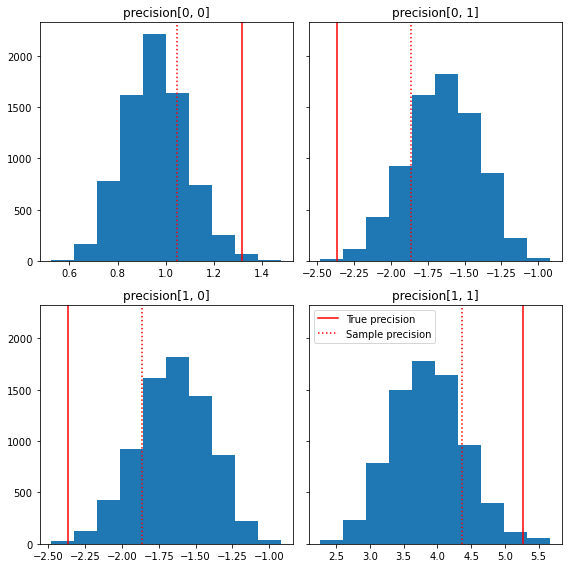

In [75]:
# If we didn't have an analytic solution, this would be the time to do some real model criticism.

fig, axes = plt.subplots(2, 2, sharey=True)
fig.set_size_inches(8, 8)
for i in range(2):
  for j in range(2):
    ax = axes[i, j]
    ax.hist(precision_samples_reshaped[:, i, j])
    ax.axvline(true_precision[i, j], color='red',
               label='True precision')
    ax.axvline(sample_precision[i, j], color='red', linestyle=':',
               label='Sample precision')
    ax.set_title('precision[%d, %d]' % (i, j))
plt.tight_layout()
plt.legend()
plt.show()

In [ ]:
fig, axes = plt.subplots(4, 4)
fig.set_size_inches(12, 12)
for i1 in range(2):
  for j1 in range(2):
    index1 = 2 * i1 + j1
    for i2 in range(2):
      for j2 in range(2):
        index2 = 2 * i2 + j2
        ax = axes[index1, index2]
        ax.scatter(precision_samples_reshaped[:, i1, j1],
                   precision_samples_reshaped[:, i2, j2], alpha=0.1)
        ax.axvline(true_precision[i1, j1], color='red')
        ax.axhline(true_precision[i2, j2], color='red')
        ax.axvline(sample_precision[i1, j1], color='red', linestyle=':')
        ax.axhline(sample_precision[i2, j2], color='red', linestyle=':')
        ax.set_title('(%d, %d) vs (%d, %d)' % (i1, j1, i2, j2))
plt.tight_layout()
plt.show()